In [17]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter, MultipleLocator
import seaborn as sns
import plotly.express as px
import plotly.io as pio
import statsmodels.formula.api as smf
import statsmodels.api as sm
import joblib
from math import ceil
from scipy import stats
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.cluster import KMeans
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.metrics import mean_absolute_error, mean_squared_error, root_mean_squared_error, r2_score, accuracy_score, classification_report, confusion_matrix, precision_score, recall_score, f1_score
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler, OneHotEncoder
from sklearn.pipeline import Pipeline
import os
os.environ['OMP_NUM_THREADS'] = '1'

# 'encoding='latin-1'' is needed because the default UTF-8 encoding couldn't inerpret either non-English characters, special symbols, or data exported from older software systems.
# The dataframe was also editted prior to being converted to a CSV file. This was due to excel not being able to convert it into a CSV file in its original size, so the dataframe had to been skimmed down in excel.
gtd_df = pd.read_csv('../data/GTD.csv', encoding='latin-1')

C:\Users\torie\AppData\Local\Temp\ipykernel_42716\3985076305.py:28: DtypeWarning:

Columns (46) have mixed types. Specify dtype option on import or set low_memory=False.



In [18]:
gtd_df.describe()

,eventid,extended,country,region,latitude,longitude,specificity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,attacktype2,attacktype3,targtype1,targsubtype1,natlty1,targtype2,targsubtype2,natlty2,targtype3,targsubtype3,natlty3,nperps,nperpcap,claimed,compclaim,weaptype1,weapsubtype1,weaptype2,weapsubtype2,weaptype3,weapsubtype3,weaptype4,weapsubtype4,all killed,all U.S citizens killed,perpetrators killed,all wounded,all U.S citizens wounded,perpetrators wounded,property,propextent,propvalue,all hostages,U.S citizen hostages,ransomamt,hostkidoutcome,any nationality similarities
count,1.997930e+05,199793.000000,199793.000000,199793.000000,195410.000000,195409.000000,199792.000000,199793.000000,199793.000000,199793.000000,199793.000000,199792.000000,199793.000000,199793.000000,199793.000000,8415.000000,656.000000,199793.000000,188587.000000,197809.000000,14395.000000,13904.000000,14094.000000,1616.000000,1531.000000,1587.000000,136254.000000,139362.000000,142736.000000,4940.000000,199793.000000,175887.000000,15867.000000,13817.000000,2303.000000,2072.000000,62.000000,61.000000,188471.000000,144079.000000,140319.000000,182352.000000,143843.000000,137674.000000,199793.000000,68760.000000,4.559700e+04,15847.000000,15792.000000,1.244000e+03,13634.000000,199793.000000
mean,2.006294e+11,0.052775,125.859760,7.342835,22.882196,32.946622,1.481596,0.987867,0.993518,0.863874,-0.378282,0.150006,0.882553,0.037229,3.354762,3.955080,5.713415,8.584845,47.597183,125.480367,10.051824,54.660026,125.584646,10.211015,56.043109,131.739130,-69.599726,-0.835213,0.079721,-6.149393,6.536260,11.060584,7.010210,11.260910,7.164568,12.549710,6.241935,11.147541,2.505956,0.037667,0.561499,3.167188,0.031173,0.138625,-0.776934,3.286184,1.774392e+05,3.142614,-0.325038,2.302186e+06,4.769180,-3.952381
std,1.218108e+09,0.223584,104.585253,2.870762,17.780072,55.023366,0.990539,0.109478,0.080248,0.342923,2.228806,0.357078,0.321952,0.189322,2.026991,2.357844,2.086716,6.614462,30.583122,91.900560,5.720794,25.755580,123.140271,5.639920,25.857265,153.336236,196.007873,9.883453,0.992535,4.310902,2.294721,6.464001,2.389053,7.741669,2.240787,8.722584,1.533083,8.308301,11.531131,5.129619,4.274176,41.713371,2.762092,1.566974,3.349550,0.479309,1.440339e+07,184.226481,6.257315,1.321085e+07,2.020735,4.676415
min,1.980010e+11,0.000000,4.000000,1.000000,-53.154613,-176.176447,1.000000,0.000000,0.000000,0.000000,-9.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,1.000000,4.000000,1.000000,1.000000,4.000000,1.000000,1.000000,4.000000,-99.000000,-99.000000,-9.000000,-9.000000,1.000000,1.000000,1.000000,1.000000,2.000000,1.000000,5.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-9.000000,1.000000,-9.900000e+01,-99.000000,-99.000000,-9.900000e+01,1.000000,-9.000000
25%,1.995072e+11,0.000000,69.000000,6.000000,11.020013,13.140468,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,2.000000,2.000000,6.000000,3.000000,23.000000,78.000000,4.000000,29.000000,60.000000,4.000000,34.000000,45.000000,-99.000000,0.000000,0.000000,-9.000000,5.000000,5.000000,5.000000,5.000000,5.000000,4.000000,5.000000,4.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,-9.900000e+01,1.000000,0.000000,-9.900000e+01,2.000000,-9.000000
50%,2.012073e+11,0.000000,97.000000,6.000000,31.074160,44.121801,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,3.000000,2.000000,7.000000,4.000000,35.000000,97.000000,14.000000,67.000000,96.000000,14.000000,67.000000,98.000000,-99.000000,0.000000,0.000000,-9.000000,6.000000,11.000000,6.000000,8.000000,8.000000,16.000000,6.000000,11.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000,-9.900000e+01,2.000000,0.000000,1.028591e+04,4.000000,0.000000
75%,2.016023e+11,0.000000,160.000000,10.000000,34.339532,69.147011,1.000000,1.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000,3.000000,7.000000,7.000000,14.000000,74.00

In [19]:
gtd_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 199793 entries, 0 to 199792
Data columns (total 75 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   eventid                       199793 non-null  int64  
 1   extended                      199793 non-null  int64  
 2   country                       199793 non-null  int64  
 3   country_txt                   199793 non-null  object 
 4   region                        199793 non-null  int64  
 5   region_txt                    199793 non-null  object 
 6   provstate                     199793 non-null  object 
 7   city                          199366 non-null  object 
 8   latitude                      195410 non-null  float64
 9   longitude                     195409 non-null  float64
 10  specificity                   199792 non-null  float64
 11  crit1                         199793 non-null  int64  
 12  crit2                         199793 non-nul

In [20]:
pd.set_option('display.max_columns', None)
gtd_df.head()

,eventid,extended,country,country_txt,region,region_txt,provstate,city,latitude,longitude,specificity,crit1,crit2,crit3,doubtterr,multiple,success,suicide,attacktype1,attacktype2,attacktype3,targtype1,targtype1_txt,targsubtype1,targsubtype1_txt,corp1,natlty1,natlty1_txt,targtype2,targtype2_txt,targsubtype2,targsubtype2_txt,corp2,target2,natlty2,natlty2_txt,targtype3,targtype3_txt,targsubtype3,targsubtype3_txt,corp3,target3,natlty3,natlty3_txt,gname,gname2,gname3,nperps,nperpcap,claimed,compclaim,weaptype1,weapsubtype1,weaptype2,weapsubtype2,weaptype3,weapsubtype3,weaptype4,weapsubtype4,all killed,all U.S citizens killed,perpetrators killed,all wounded,all U.S citizens wounded,perpetrators wounded,property,propextent,propvalue,all hostages,U.S citizen hostages,divert,ransomamt,hostkidoutcome,any nationality similarities,related
0,198001010001,0,155,West Bank and Gaza Strip,10,Middle East & North Africa,West Bank,Nablus,32.222271,35.253506,1.0,1,1,1,0,0.0,0,0,3,NaN,NaN,2,Government (General),21.0,Government Building/Facility/Office,NaN,97.0,Israel,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Palestinians,NaN,NaN,NaN,NaN,NaN,NaN,6,16.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,NaN
1,198001010002,0,603,United Kingdom,8,Western Europe,Northern Ireland,Lisnaskea,54.253718,-7.441060,1.0,1,1,1,0,0.0,1,0,3,NaN,NaN,1,Business,7.0,Retail/Grocery/Bakery,NaN,233.0,Northern Ireland,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Irish Republican Army (IRA),NaN,NaN,NaN,NaN,NaN,NaN,6,16.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN
2,198001010003,0,603,United Kingdom,8,Western Europe,Northern Ireland,Unknown,54.787715,-6.492314,4.0,1,1,1,0,0.0,0,0,3,NaN,NaN,14,Private Citizens & Property,73.0,Vehicles/Transportation,NaN,233.0,Northern Ireland,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Irish Republican Army (IRA),NaN,NaN,NaN,NaN,NaN,NaN,6,16.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN
3,198001010004,0,603,United Kingdom,8,Western Europe,Northern Ireland,Middletown,54.293235,-6.842351,1.0,1,1,0,1,0.0,1,0,3,NaN,NaN,4,Military,27.0,Military Barracks/Base/Headquarters/Checkpost,British Army,233.0,Northern Ireland,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Irish Republican Army (IRA),NaN,NaN,NaN,NaN,NaN,NaN,6,16.0,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,0.0,NaN,NaN,1,4.0,NaN,NaN,NaN,NaN,NaN,NaN,1,NaN
4,198001010005,0,92,India,6,South Asia,Manipur,Imphal,24.798346,93.940430,1.0,1,1,1,0,0.0,1,0,1,NaN,NaN,2,Government (General),15.0,Politician or Political Party Movement/Meeting...,I.C.P.,92.0,India,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Maoists,NaN,NaN,NaN,NaN,NaN,NaN,13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,0.0,NaN,NaN,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-9,NaN


In [21]:
# The doubtterr column consisted of three numbers:
# 1 equalled 'Yes' and stated 'There is doubt as to whether the incident is an act of terrorism.'
# 0 equalled 'No' and stated 'There is essentially no doubt as to whether the incident is an act of terrorism.'
# -9 basically meant 'Unknown', the system didn't fully take place until 1997, so data before that time didn't always have the doubtterr column values.

# To ensure the code represented acts of terrorism, all the values that were other than 0 were dropped.

gtd_df = gtd_df[gtd_df['doubtterr'] == 0]
gtd_df['doubtterr'].size

153521

In [22]:
# This renames some of the columns to better make sense on what they do and have them look cleaner on certain graphs.

gtd_df = gtd_df.rename(columns={
    'region_txt': 'Region Name',
    'country_txt': 'Country Name',
    'latitude': 'Latitude',
    'longitude': 'Longitude',
    'all killed': 'Total Killed',
    'attacktype1': 'Attack Type',
    'all wounded': 'Total Wounded',
    'gname': 'Group Name'
})

In [23]:
# This was originally a column of its own call 'attacktype1_txt', but was mistakenly deleted before it was converted into a CSV. Using the codebook provided by the University of Maryland, I changed the numbers into their proper naming conventions.

attacktype_mapping = {
    1: 'ASSASSINATION',
    2: 'ARMED ASSAULT',
    3: 'BOMBING/EXPLOSION',
    4: 'HIJACKING',
    5: 'HOSTAGE TAKING (BARRICADE INCIDENT)',
    6: 'HOSTAGE TAKING (KIDNAPPING)',
    7: 'FACILITY / INFRASTRUCTURE ATTACK',
    8: 'UNARMED ASSAULT',
    9: 'UNKNOWN'
}

gtd_df['Attack Type'] = gtd_df['Attack Type'].replace(attacktype_mapping)

In [24]:
# This fills in nulls.

# Fill multiple columns with different values in one line
gtd_df = gtd_df.fillna({
    'Total Killed': 0,
    'all wounded': 'Unknown',
    'gname': 'Unknown',
    'attacktype1': 'Unknown'
})

In [25]:
'''KEEP COMMENTTED OUT, CAUSE SOME ISSUES'''

import kaleido

# This map model represent terroristic attacks by region. When hovering over the points it displays data from the gtd_df from the following columns: Country Name, Region Name, Total Killed, Latitude and Longitude, Attack Type, and Group Name.

original_colors = px.colors.qualitative.Dark24
unique_regions = gtd_df['Region Name'].unique()  # This preserves the original order when using Dark24. This line prevents moving the dark blue color onto another region on the map.

# This changes the color of North America on the map to a color more easily visible while keeping rest of the countries as Dark24.
region_colors = {}
for i, region in enumerate(unique_regions):
    if region == 'North America':
        region_colors[region] = '#E9FA32'
    else:
        region_colors[region] = original_colors[i % len(original_colors)]

fig = px.scatter_mapbox( 
    data_frame=gtd_df,
    lat='Latitude',
    lon='Longitude',
    color='Region Name',
    hover_name='Country Name',
    hover_data=['Attack Type', 'Group Name'],
    size='Total Killed',
    opacity=.5,
    size_max=30,
    zoom=1,
    center={'lat': 20, 'lon': 0},
    mapbox_style='carto-darkmatter',
    title='Map of the Global Terrorism Database By Region',
    color_discrete_map=region_colors,
    template='plotly_dark',
    width=1400,
    height=1200)

# This sets the title locatoin and size.
fig.update_layout(
    title={
        'text': 'Map of the Global Terrorism Database By Region',
        'font': dict(size=28),
        'x': 0.5,
        'y': 0.95,
        'xanchor': 'center',
        'yanchor': 'top'
    } 
)
fig.show()

fig.write_image('Map of the Global Terrorism Database By Region.png',  width=1600, height=1200, scale=3)

C:\Users\torie\AppData\Local\Temp\ipykernel_42716\532868078.py:18: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



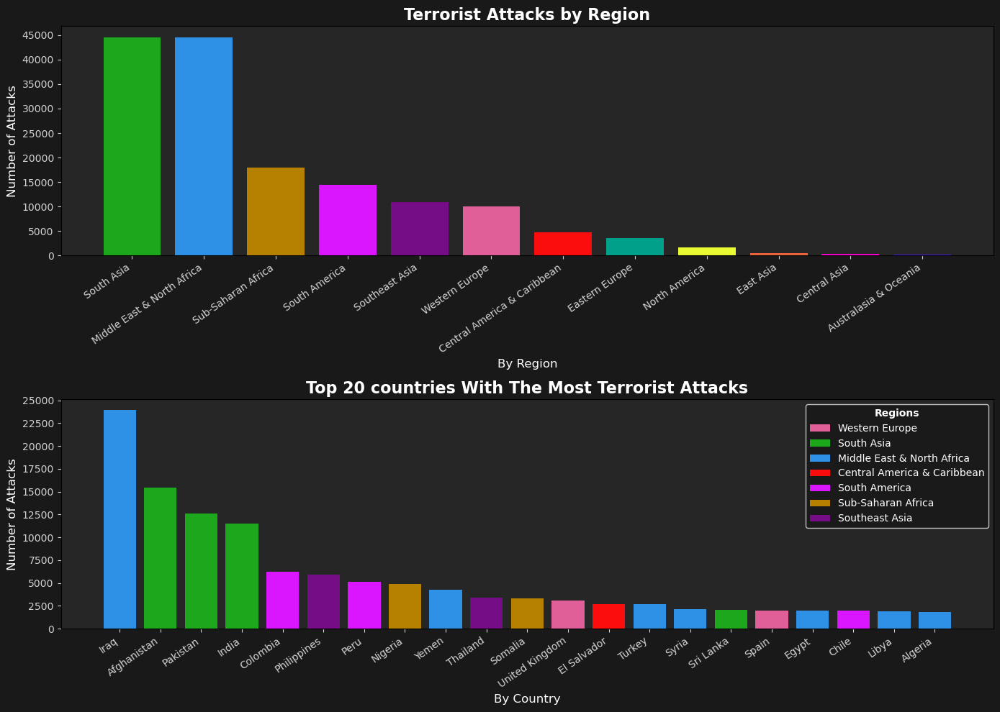

In [26]:
from matplotlib.patches import Patch

# This applies a dark theme for better visual appearance.
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(14, 10))
fig.patch.set_facecolor('#191919')
ax1.set_facecolor('#262626')
ax2.set_facecolor('#262626')

# This configures text colors to be readable for the dark theme.
plt.rcParams['text.color'] = 'white'
plt.rcParams['axes.labelcolor'] = 'white'
plt.rcParams['xtick.color'] = 'lightgray'
plt.rcParams['ytick.color'] = 'lightgray'

region_counts = gtd_df['Region Name'].value_counts().sort_values(ascending=False)
country_counts = gtd_df['Country Name'].value_counts().sort_values(ascending=False)
colors = [region_colors[region] for region in region_counts.index] # Sets the colors of the bars to the same colors represented for regions in the scatter_mapbox.
country_region_colors = [region_colors[gtd_df[gtd_df['Country Name'] == country]['Region Name'].iloc[0]] for country in country_counts.index[0:21]] # Sets the colors of the bars to the same colors represented for regions in the scatter_mapbox.
represented_regions = gtd_df[gtd_df['Country Name'].isin(country_counts.index[0:21])]['Region Name'].unique() # Only displays the regions represented within the second graph's legend.
legend_elements = [Patch(facecolor=region_colors[region], label=region) for region in represented_regions] # Sets the legend to correlate with region colors for the second graph.

# Bar chart for terrorist attacks by region.
ax1.bar(region_counts.index, region_counts.values, color=colors, linewidth=0.8)
ax1.set_xlabel('By Region', fontsize=12)
ax1.set_ylabel('Number of Attacks', fontsize=12)
ax1.set_title('Terrorist Attacks by Region', fontsize=16, fontweight='bold')
ax1.tick_params(axis='x', rotation=35)
ax1.locator_params(axis='y', nbins = 10)

# Bar chart for terrorist attacks by top 20 countries.
ax2.bar(country_counts.index[0:21], country_counts.values[0:21], color=country_region_colors, linewidth=0.8)
ax2.set_xlabel('By Country', fontsize=12)
ax2.set_ylabel('Number of Attacks', fontsize=12)
ax2.set_title('Top 20 countries With The Most Terrorist Attacks', fontsize=16, fontweight='bold')
ax2.tick_params(axis='x', rotation=35)
ax2.locator_params(axis='y', nbins = 12)
ax2.legend(handles=legend_elements, loc='best', fontsize=10, title='Regions', 
           title_fontproperties={'weight': 'bold'}, facecolor='#191919', 
           edgecolor='lightgray', framealpha=0.9)

plt.setp(ax1.xaxis.get_majorticklabels(), ha='right')
plt.setp(ax2.xaxis.get_majorticklabels(), ha='right')
plt.tight_layout()
plt.show()

In [27]:
# This predicts terrorist attacks by region.

# This fills in missing features in Total Wounded.
gtd_df['Total Wounded'] = pd.to_numeric(gtd_df['Total Wounded'], errors='coerce').fillna(0)

# This encodes both region and attack into numeric data.
encoder_region = LabelEncoder()
gtd_df['Region Name'] = encoder_region.fit_transform(gtd_df['Region Name'])
encoder_attack = LabelEncoder()
gtd_df['Attack Type'] = encoder_attack.fit_transform(gtd_df['Attack Type'].fillna('UNKNOWN'))
encoder_gname = LabelEncoder()
gtd_df['Group Name'] = encoder_gname.fit_transform(gtd_df['Group Name'])
encoder_related = LabelEncoder()
gtd_df['related'] = encoder_related.fit_transform(gtd_df['related'])
encoder_corp = LabelEncoder()
gtd_df['corp1'] = encoder_corp.fit_transform(gtd_df['corp1'])

gtd_df['Any_Deaths'] = (gtd_df['Total Killed'] > 0).astype(int) # This converts the data into zeros and ones. Zero if no deaths occured, and one if any deaths occured.
gtd_df['Any_Wounded'] = (gtd_df['Total Wounded'] > 0).astype(int) # This converts the data into zeros and ones. Zero if no injuries occured, and one if any injuries occured.
gtd_df['Mass_Casualty'] = ((gtd_df['Total Killed'] + gtd_df['Total Wounded']) > 10).astype(int) # If the combined number of Total Wounded and Total Killed is greater than 10 it is considered a mass casualty event.

X = gtd_df[['Total Killed', 'Total Wounded', 'Attack Type', 'any nationality similarities', 'targtype1', 'targsubtype1', 'Group Name', 'related', 'corp1']]
y = gtd_df['Region Name']

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, stratify=y
)

forest_model = RandomForestClassifier(n_estimators=200, random_state=42, class_weight='balanced')
forest_model.fit(X_train, y_train)
forest_pred = forest_model.predict(X_test)

# Evaluate the enhanced model
accuracy = accuracy_score(y_test, forest_pred)
print(f'\nEnhanced Model Accuracy: {accuracy:.3f}')

# Gives analysis on which feature affects the model the most from decending order.
feature_names = ['Total Killed', 'Total Wounded', 'Attack Type', 'any nationality similarities', 'targtype1', 'targsubtype1', 'Group Name', 'related', 'corp1']
importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': forest_model.feature_importances_
}).sort_values('Importance', ascending=False)

print('\nFeature Importance (Geographic Enhanced):')
print(importance_df)

print('\nClassification Report:')
print(classification_report(y_test, forest_pred, target_names=encoder_region.classes_))

# This trains the model 5 times and calcuates the average accuracy.
cv_scores = cross_val_score(forest_model, X_train, y_train, cv=5, scoring='accuracy')
print(f'\nCross-validation accuracy: {cv_scores.mean():.3f} (+/- {cv_scores.std() * 2:.3f})')
importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': forest_model.feature_importances_
}).sort_values('Importance', ascending=False)


Enhanced Model Accuracy: 0.758

Feature Importance (Geographic Enhanced):
                        Feature  Importance
6                    Group Name    0.287142
8                         corp1    0.237622
5                  targsubtype1    0.149678
4                     targtype1    0.062543
2                   Attack Type    0.059550
1                 Total Wounded    0.055761
7                       related    0.054050
0                  Total Killed    0.048890
3  any nationality similarities    0.044765

Classification Report:
                             precision    recall  f1-score   support

      Australasia & Oceania       0.22      0.55      0.31        40
Central America & Caribbean       0.71      0.77      0.74       943
               Central Asia       0.05      0.15      0.07        80
                  East Asia       0.30      0.36      0.33       100
             Eastern Europe       0.35      0.42      0.38       714
 Middle East & North Africa       0.78      0.

In [28]:
# Creates the file path for the model in order for the Predictions Interactive Map (Streamlit).py file to work.

import os
import joblib

os.makedirs('../models', exist_ok=True)
joblib.dump(forest_model, '../models/forest_model.joblib')

['../models/forest_model.joblib']

Torrorist operate more locally

In [30]:
# Correct and Incorrect for Region Predictions.

X_test['Latitude'] = gtd_df.loc[X_test.index, 'Latitude']
X_test['Longitude'] = gtd_df.loc[X_test.index, 'Longitude']
X_test['Actual Region'] = encoder_region.inverse_transform(y_test)
X_test['Predicted Region'] = encoder_region.inverse_transform(forest_pred)

# This calculates prediction accuracy.
X_test['Correct Prediction'] = (y_test.values == forest_pred)
correct_count = X_test['Correct Prediction'].sum()
total_count = len(X_test)
accuracy_pct = correct_count / total_count

# This maps Correct and Incorrect Predictions.
X_test['Prediction Status'] = X_test['Correct Prediction'].map({True: 'Correct', False: 'Incorrect'})

fig = px.scatter_mapbox(
    X_test, 
    lat='Latitude', 
    lon='Longitude',
    color='Prediction Status',
    color_discrete_map={'Correct': '#00FF00', 'Incorrect': '#FF0000'},
    hover_name='Actual Region',
    hover_data={
        'Predicted Region': True,
        'Latitude': ':.3f',
        'Longitude': ':.3f',
        'Prediction Status': True
    },
    opacity=0.7,
    size_max=8,
    zoom= 1.3,
    center={'lat': 20, 'lon': 0},
    mapbox_style='carto-darkmatter',
    title=f"Machine Learning Model Prediction Accuracy on World Map<br>Model correctly predicted {correct_count:,} out of {total_count:,} locations<br>Geography Enables {accuracy_pct:.1%} Accuracy<br><span style='color:green'>Green = Correct Predictions</span> | <span style='color:red'>Red = Incorrect Predictions</span>",
    template='plotly_dark',
    width=1400,
    height=1200
)

# This sets the title and legend position.
fig.update_layout(
    title_font_size=18,
    title_x=0.5,
    title_y=.98,
    font=dict(size=12),
    margin=dict(t=100),
    legend=dict(
        yanchor='top',
        y=1,
        xanchor='right',
        x=1,
        bgcolor='#282828',
        bordercolor='#1B1B1B',
        borderwidth=3,
        font=dict(color='#FFFFFF', size=14)
    )
)

fig.show()

fig.write_image('prediction_map.png', width=1400, height=1200, scale=2)

C:\Users\torie\AppData\Local\Temp\ipykernel_42716\2664783376.py:17: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



In [ ]:
gtd_df['Region Name'] = encoder_region.inverse_transform(gtd_df['Region Name'])

# 1. Two-Sample T-Test: Compare high-casualty vs low-casualty regions
region_casualties = gtd_df.groupby('Region Name')['Total Killed'].mean().sort_values(ascending=False)
print('Regional Average Casualties per Attack:')
for region, avg_casualties in region_casualties.items():
    print(f'   {region}: {avg_casualties:.2f}')

# Define high-risk (top 3) vs low-risk regions
high_risk_regions = region_casualties.head(3).index.tolist()
print(f'\nHigh-risk regions: {high_risk_regions}')

# Separate casualty data
high_risk_casualties = gtd_df[gtd_df['Region Name'].isin(high_risk_regions)]['Total Killed']
low_risk_casualties = gtd_df[~gtd_df['Region Name'].isin(high_risk_regions)]['Total Killed']

# Perform two-sample t-test
t_stat, p_value = stats.ttest_ind(high_risk_casualties, low_risk_casualties)

print(f'\n1. HIGH-RISK vs LOW-RISK REGIONS T-TEST:')
print(f'   High-risk mean casualties: {high_risk_casualties.mean():.2f}')
print(f'   Low-risk mean casualties: {low_risk_casualties.mean():.2f}')
print(f'   T-statistic: {t_stat:.4f}')
print(f'   P-value: {p_value:.2e}')

if p_value < 0.05:
    print('   STATISTICALLY SIGNIFICANT: High-risk regions have significantly different casualty rates')
    effect_size = (high_risk_casualties.mean() - low_risk_casualties.mean()) / np.sqrt(((len(high_risk_casualties)-1)*high_risk_casualties.var() + (len(low_risk_casualties)-1)*low_risk_casualties.var()) / (len(high_risk_casualties) + len(low_risk_casualties) - 2))
    print(f'   Effect size (Cohen's d): {effect_size:.3f}')
else:
    print('   NOT STATISTICALLY SIGNIFICANT')

# 2. One-Sample T-Tests: Each region vs global average
global_mean = gtd_df['Total Killed'].mean()
print(f'\n2. REGIONAL vs GLOBAL AVERAGE COMPARISON:')
print(f'   Global average casualties per attack: {global_mean:.2f}')

for region in gtd_df['Region Name'].unique():
    region_data = gtd_df[gtd_df['Region Name'] == region]['Total Killed']
    
    if len(region_data) > 30:  # Sufficient sample size for t-test
        t_stat, p_value = stats.ttest_1samp(region_data, global_mean)
        
        print(f'\n   {region}:')
        print(f'   Regional mean: {region_data.mean():.2f} (n={len(region_data)})')
        print(f'   T-statistic: {t_stat:.4f}, P-value: {p_value:.4f}')
        
        if p_value < 0.05:
            direction = 'SIGNIFICANTLY ABOVE' if region_data.mean() > global_mean else 'SIGNIFICANTLY BELOW'
            print(f'   {direction} global average')
        else:
            print(f'   NOT SIGNIFICANTLY DIFFERENT from global average')

Regional Average Casualties per Attack:
   Sub-Saharan Africa: 4.20
   North America: 2.58
   Middle East & North Africa: 2.49
   South Asia: 2.21
   East Asia: 2.13
   Central Asia: 1.92
   Central America & Caribbean: 1.57
   Eastern Europe: 1.46
   South America: 1.27
   Southeast Asia: 1.03
   Australasia & Oceania: 0.65
   Western Europe: 0.33

High-risk regions: ['Sub-Saharan Africa', 'North America', 'Middle East & North Africa']

1. HIGH-RISK vs LOW-RISK REGIONS T-TEST:
   High-risk mean casualties: 2.97
   Low-risk mean casualties: 1.64
   T-statistic: 24.5252
   P-value: 1.44e-132
   STATISTICALLY SIGNIFICANT: High-risk regions have significantly different casualty rates
   Effect size (Cohen's d): 0.127

2. REGIONAL vs GLOBAL AVERAGE COMPARISON:
   Global average casualties per attack: 2.19

   Middle East & North Africa:
   Regional mean: 2.49 (n=44476)
   T-statistic: 5.8592, P-value: 0.0000
   SIGNIFICANTLY ABOVE global average

   Western Europe:
   Regional mean: 0.33 (

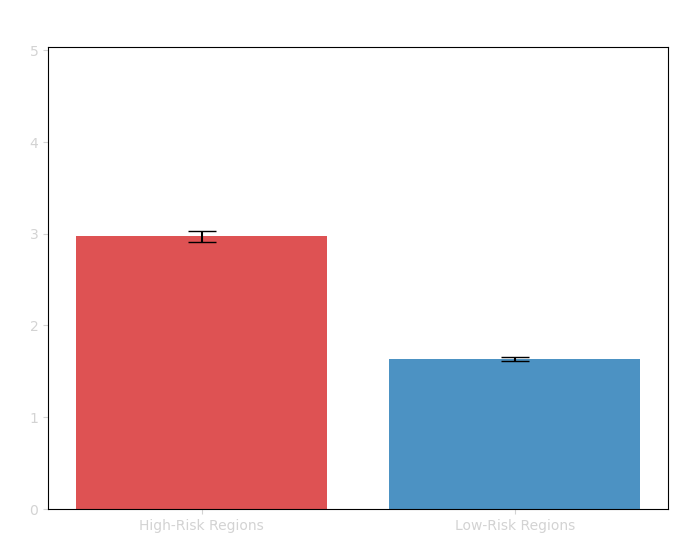

In [31]:
import matplotlib.pyplot as plt
import numpy as np

# Calculate means and standard errors
means = [high_risk_casualties.mean(), low_risk_casualties.mean()]
std_errs = [high_risk_casualties.std(ddof=1)/np.sqrt(len(high_risk_casualties)),
            low_risk_casualties.std(ddof=1)/np.sqrt(len(low_risk_casualties))]

groups = ['High-Risk Regions', 'Low-Risk Regions']

fig, ax = plt.subplots(figsize=(8, 6))
bars = ax.bar(groups, means, yerr=std_errs, capsize=10, color=['#d62728', '#1f77b4'], alpha=0.8)
ax.set_ylabel('Average Casualties per Attack')
ax.set_title('Comparison of Average Casualties\nHigh-Risk vs Low-Risk Regions')
ax.set_ylim(0, max(means) + max(std_errs) + 2)

# Annotate p-value
ax.text(0.5, max(means) + max(std_errs), f'p-value: {p_value:.3e}', ha='center', va='bottom', fontsize=12)

plt.show()

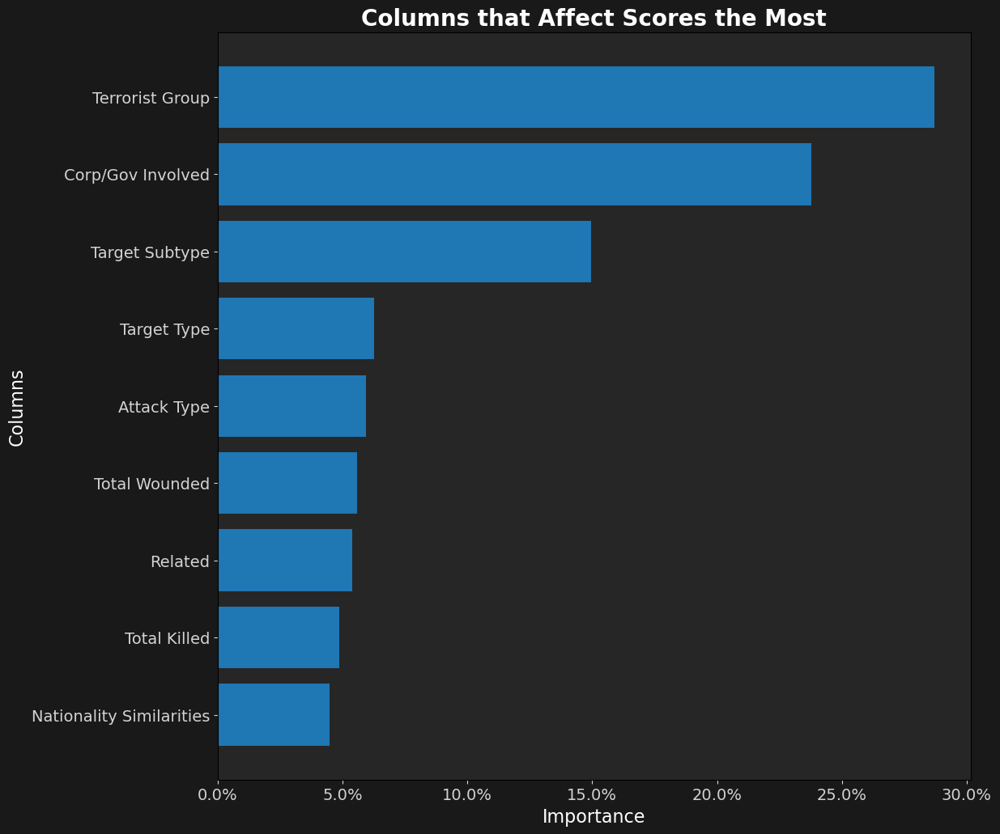

In [ ]:
# This is a horizontal bar graph that displays which column affects the model the most.
bar_df = gtd_df.copy()[['Total Killed', 'Total Wounded', 'Attack Type', 'any nationality similarities', 'targtype1', 'targsubtype1', 'Group Name', 'related', 'corp1']]

bar_df = bar_df.rename(columns={
    'any nationality similarities': 'Nationality Similarities',
    'targtype1': 'Target Type',
    'targsubtype1': 'Target Subtype',
    'Group Name': 'Terrorist Group',
    'related' : 'Related',
    'corp1': 'Corp/Gov Involved'
})

feature_names = ['Total Killed', 'Total Wounded', 'Attack Type', 'Nationality Similarities', 'Target Type', 'Target Subtype', 'Terrorist Group', 'Related', 'Corp/Gov Involved']
importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': forest_model.feature_importances_
}).sort_values('Importance', ascending=False)

fig, ax = plt.subplots(figsize=(12, 12))
fig.patch.set_facecolor('#191919')
ax.set_facecolor('#262626')
ax.barh(importance_df['Feature'], importance_df['Importance'])
ax.set_xlabel('Importance', fontsize=16)
ax.set_ylabel('Columns', fontsize=16)
ax.set_title('Columns that Affect Scores the Most', fontsize=20, fontweight='bold')
ax.tick_params(axis='both', labelsize=14)
ax.xaxis.set_major_formatter(PercentFormatter(1.0)) # Changes the x-axis to percentage format.
ax.xaxis.set_major_locator(MultipleLocator(0.05)) # Sets the x-axis major ticks to increments of 5%.
ax.invert_yaxis()
plt.show()